<a href="https://colab.research.google.com/github/vornitier/depth_inpainting/blob/main/photo_to_3d.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Experimentation of [**3D Photography using Context-aware Layered Depth Inpainting**](https://shihmengli.github.io/3D-Photo-Inpainting/).




In [ ]:
!nvidia-smi

Thu May  6 21:11:56 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# libraries
!pip install -q vispy==0.6.4
!pip install -q moviepy==1.0.2
!pip install -q transforms3d==0.3.1
!pip install -q networkx==2.3
!pip install -q -U watermark

     |████████████████████████████████| 2.3MB 21.4MB/s 
     |████████████████████████████████| 890kB 53.7MB/s 
     |████████████████████████████████| 7.9MB 16.8MB/s 
     |████████████████████████████████| 3.3MB 45.1MB/s 
     |████████████████████████████████| 26.9MB 112kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 71kB 9.9MB/s 
     |████████████████████████████████| 1.8MB 19.0MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.


In [ ]:
%reload_ext watermark
%watermark -v -p torch,vispy,moviepy,transforms3d,networkx

Python implementation: CPython
Python version       : 3.7.10
IPython version      : 5.5.0

torch       : 1.8.1+cu101
vispy       : 0.6.4
moviepy     : 1.0.2
transforms3d: 0.3.1
networkx    : 2.3



In [ ]:
# helper functions that will help visualize depth estimations and final results:
from IPython.display import HTML
from base64 import b64encode

def show_inpainting(image_file, video_file):
  image_content = open(image_file, 'rb').read()
  video_content = open(video_file, 'rb').read()
  image_data = "data:image/jpg;base64," + b64encode(image_content).decode()
  video_data = "data:video/mp4;base64," + b64encode(video_content).decode()
  html = HTML(f"""
  <img height=756 src={image_data} />
  <video height=756 controls loop>
        <source src={video_data} type='video/mp4'>
  </video>
  """)
  return html

def show_depth_estimation(image_file, depth_file):
  image_content = open(image_file, 'rb').read()
  depth_content = open(depth_file, 'rb').read()
  image_data = "data:image/jpg;base64," + b64encode(image_content).decode()
  depth_data = "data:image/png;base64," + b64encode(depth_content).decode()
  html = HTML(f"""
  <img height=756 src={image_data} />
  <img height=756 src={depth_data} />
  """)
  return html

The `show_inpainting()` function shows the inpainted video along with the original photo. `show_depth_estimation()` shows the estimated depth of each pixel of the image (more on that later).

mkdir: cannot create directory ‘image’: File exists



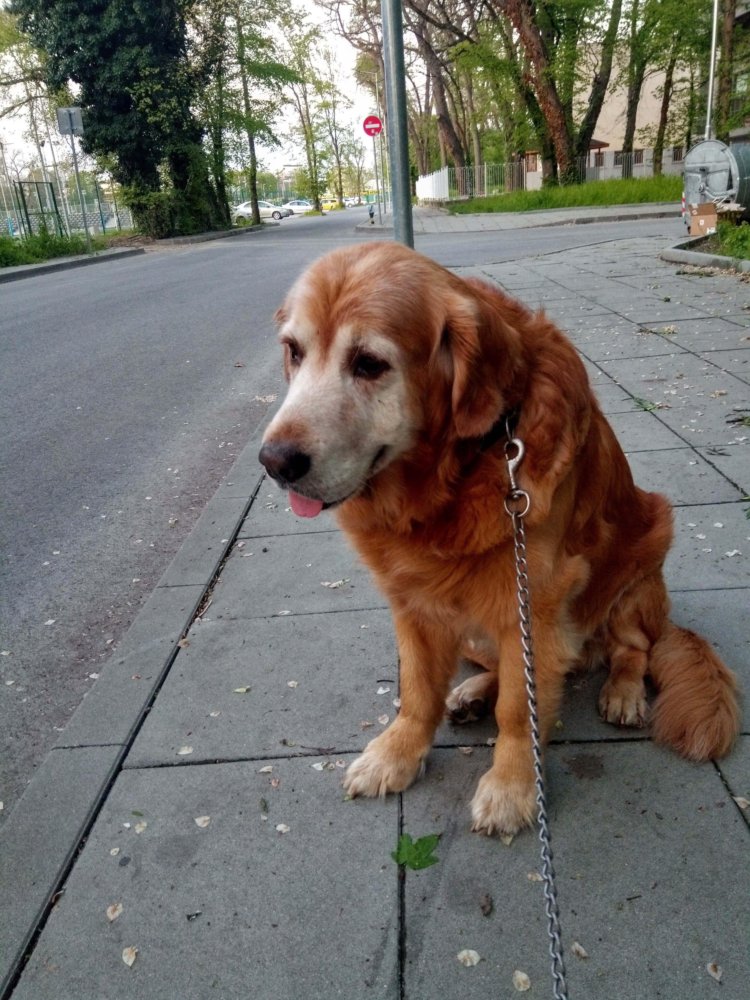

In [ ]:
!mkdir image

!gdown -q --id 1VDT5YhANPJczevyhTdasJO5Zexl2l_fd -O image/dog.jpg
!gdown -q --id 1CAsRBub83ptC_zPWFRZIDQDU47tFy_ST -O image/dog-inpainting.mp4

show_inpainting('image/dog.jpg', 'image/dog-inpainting.mp4')

On the left, we have a photo of Ahil that I've taken with my phone. On the right is the result of the 3D inpainting that you're going to learn how to do.

## Making 3D photos

*Inpainting* refers to the process of recovering parts of images and videos that were lost or purposefully removed.

The paper [3D Photography using Context-aware Layered Depth Inpainting](https://shihmengli.github.io/3D-Photo-Inpainting/) introduces a method to convert 2D photos into 3D using inpainting techniques.

The full source code of the project is available on [GitHub](https://github.com/vt-vl-lab/3d-photo-inpainting). Let's clone the repo and download some pre-trained models:

In [ ]:
%cd /content/
!git clone https://github.com/vt-vl-lab/3d-photo-inpainting.git
%cd 3d-photo-inpainting
!git checkout e804c1cb2fd695be50946db2f1eb17134f6d1b38
!sh download.sh

/content
Cloning into '3d-photo-inpainting'...
remote: Enumerating objects: 350, done.
remote: Total 350 (delta 0), reused 0 (delta 0), pack-reused 350
Receiving objects: 100% (350/350), 130.13 MiB | 43.45 MiB/s, done.
Resolving deltas: 100% (192/192), done.
/content/3d-photo-inpainting
Note: checking out 'e804c1cb2fd695be50946db2f1eb17134f6d1b38'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at e804c1c Manually edited depth map.
--2021-05-06 21:38:25--  https://filebox.ece.vt.edu/~jbhuang/project/3DPhoto/model/color-model.pth
Resolving filebox.ece.vt.edu (filebox.ece.vt.edu)... 128.173.88.43
Connecting to filebox.ece.vt.

In [ ]:
!rm depth/*
!rm image/*
!rm video/*

Let's clear up the demo files, provided by the project, and download our own content:

In [ ]:
!gdown --id 1b4MjYo_D5sps8F6JmYnomandLyQhjo6Z -O config.yml
!gdown --id 152Hm3qVu5pI7LtF2Jz6hsQTq9s3O7DLw -O image/sea.jpg
!gdown --id 1XpJLgwpordZGctx5xvYws3gpfAu8DPp_ -O image/dog.jpg
!gdown --id 10GdgZh_7_BZSXF4RC5a66U0ZIs0FGJhc -O image/paris.jpg

Downloading...
From: https://drive.google.com/uc?id=1b4MjYo_D5sps8F6JmYnomandLyQhjo6Z
To: /content/3d-photo-inpainting/config.yml
100% 1.22k/1.22k [00:00<00:00, 2.18MB/s]
Downloading...
From: https://drive.google.com/uc?id=152Hm3qVu5pI7LtF2Jz6hsQTq9s3O7DLw
To: /content/3d-photo-inpainting/image/sea.jpg
3.28MB [00:00, 106MB/s]
Downloading...
From: https://drive.google.com/uc?id=1XpJLgwpordZGctx5xvYws3gpfAu8DPp_
To: /content/3d-photo-inpainting/image/dog.jpg
100% 1.73M/1.73M [00:00<00:00, 27.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=10GdgZh_7_BZSXF4RC5a66U0ZIs0FGJhc
To: /content/3d-photo-inpainting/image/paris.jpg
100% 964k/964k [00:00<00:00, 15.2MB/s]


The images you want to convert into 3D photos need to go into the `image` directory. For our example, I am adding 2 from my personal collection.

We're going to use (mostly) the default config and make sure that offscreen rendering is disabled:

In [ ]:
!cat config.yml

depth_edge_model_ckpt: checkpoints/edge-model.pth
depth_feat_model_ckpt: checkpoints/depth-model.pth
rgb_feat_model_ckpt: checkpoints/color-model.pth
MiDaS_model_ckpt: MiDaS/model.pt
fps: 40
num_frames: 240
x_shift_range: [0.00, 0.00, -0.02, -0.02]
y_shift_range: [0.00, 0.00, -0.02, -0.00]
z_shift_range: [-0.05, -0.05, -0.07, -0.07]
traj_types: ['double-straight-line', 'double-straight-line', 'circle', 'circle']
video_postfix: ['dolly-zoom-in', 'zoom-in', 'circle', 'swing']
specific: ''
longer_side_len: 960
src_folder: image
depth_folder: depth
mesh_folder: mesh
video_folder: video
load_ply: False
save_ply: True
inference_video: True
gpu_ids: 0
offscreen_rendering: False
img_format: '.jpg'
depth_format: '.npy'
require_midas: True
depth_threshold: 0.04
ext_edge_threshold: 0.002
sparse_iter: 5
filter_size: [7, 7, 5, 5, 5]
sigma_s: 4.0
sigma_r: 0.5
redundant_number: 12
background_thickness: 70
context_thickness: 140
background_thickness_2: 70
context_thickness_2: 70
discount_factor: 1.00


To start the inpainting process, we need to execute the `main.py` file and pass the config:

In [ ]:
!python main.py --config config.yml

running on device 0
  0% 0/3 [00:00<?, ?it/s]Current Source ==>  paris
Running depth extraction at 1620337280.6995835
initialize
device: cpu
start processing
  processing image/paris.jpg (1/1)
torch.Size([1, 3, 384, 352])
finished
Start Running 3D_Photo ...
Loading edge model at 1620337295.9409497
Loading depth model at 1620337306.7285101
Loading rgb model at 1620337307.5325243
Writing depth ply (and basically doing everything) at 1620337308.2824285
Writing mesh file mesh/paris.ply ...
Making video at 1620337463.6381273
fov: 53.13010235415598
Moviepy - Building video video/paris_dolly-zoom-in.mp4.
Moviepy - Writing video video/paris_dolly-zoom-in.mp4

  0% 0/3 [03:38<?, ?it/s]
t:   0% 0/241 [00:00<?, ?it/s, now=None]
t:   1% 2/241 [00:00<00:40,  5.84it/s, now=None]
t:   1% 3/241 [00:00<00:36,  6.45it/s, now=None]
t:   8% 19/241 [00:00<00:24,  9.06it/s, now=None]
t:  14% 34/241 [00:00<00:16, 12.59it/s, now=None]
t:  20% 47/241 [00:00<00:11, 17.24it/s, now=None]
t:  24% 57/241 [00:01<00:


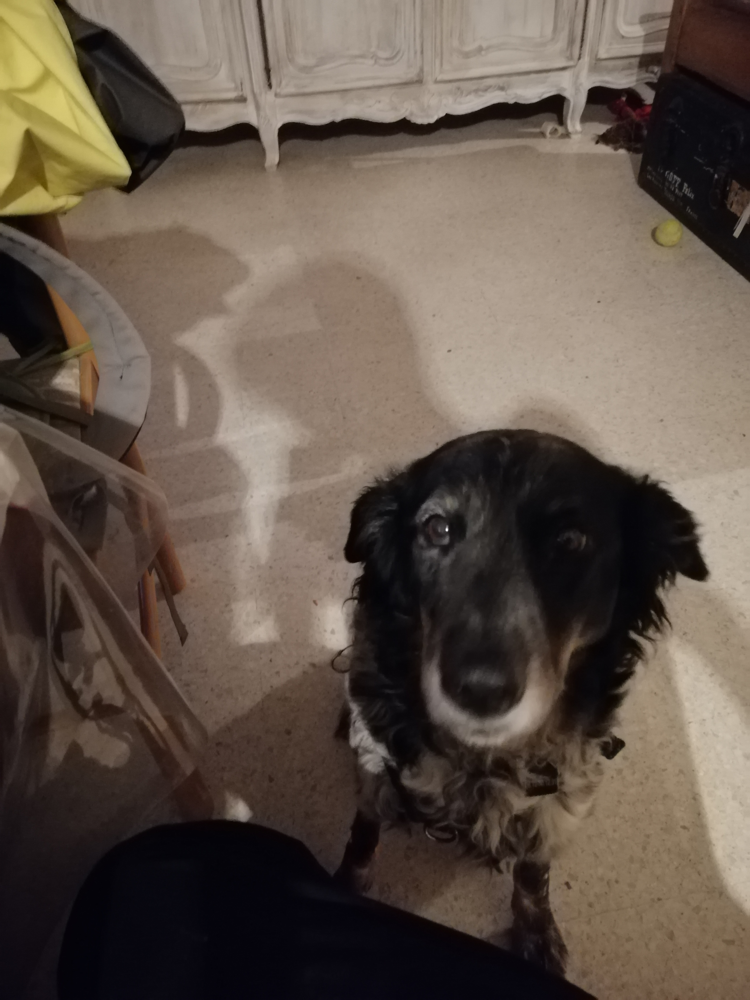
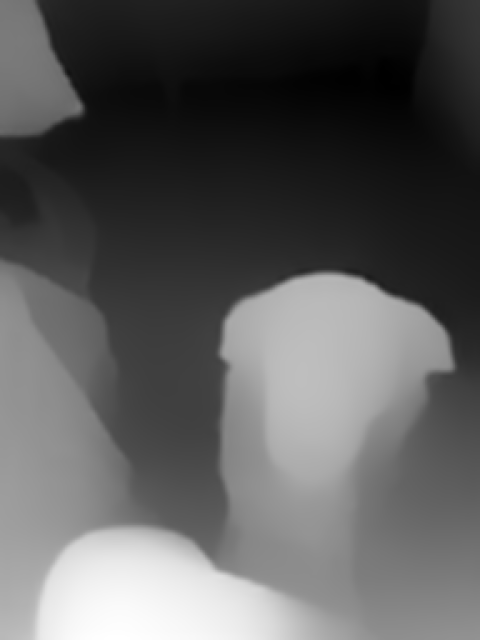

In [ ]:
show_depth_estimation('image/dog.jpg', 'depth/dog.png')


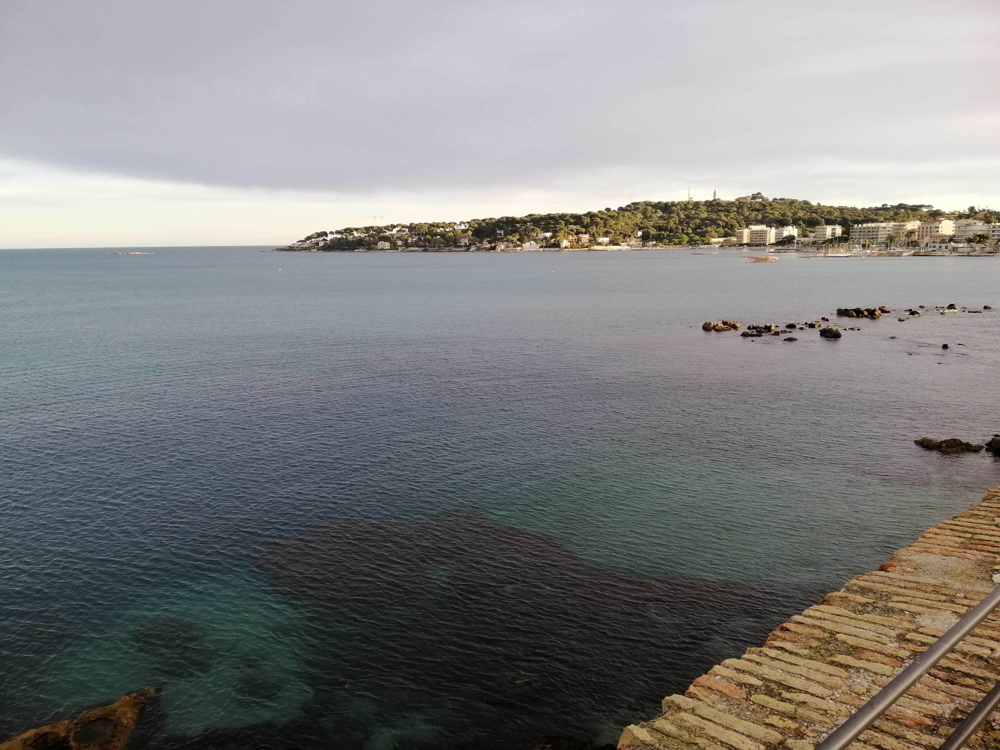
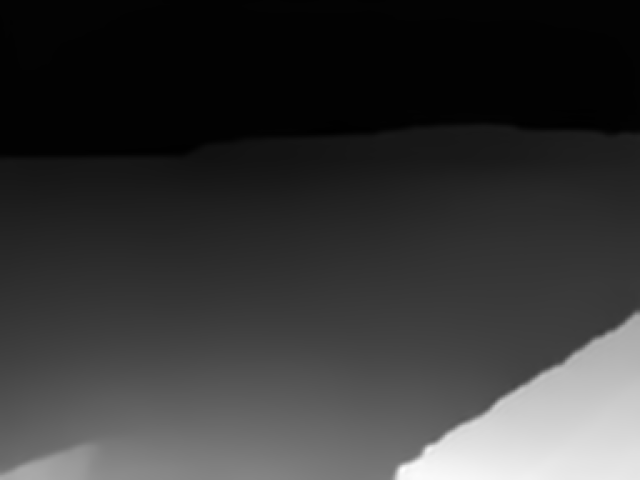

In [ ]:
show_depth_estimation('image/sea.jpg', 'depth/sea.png')


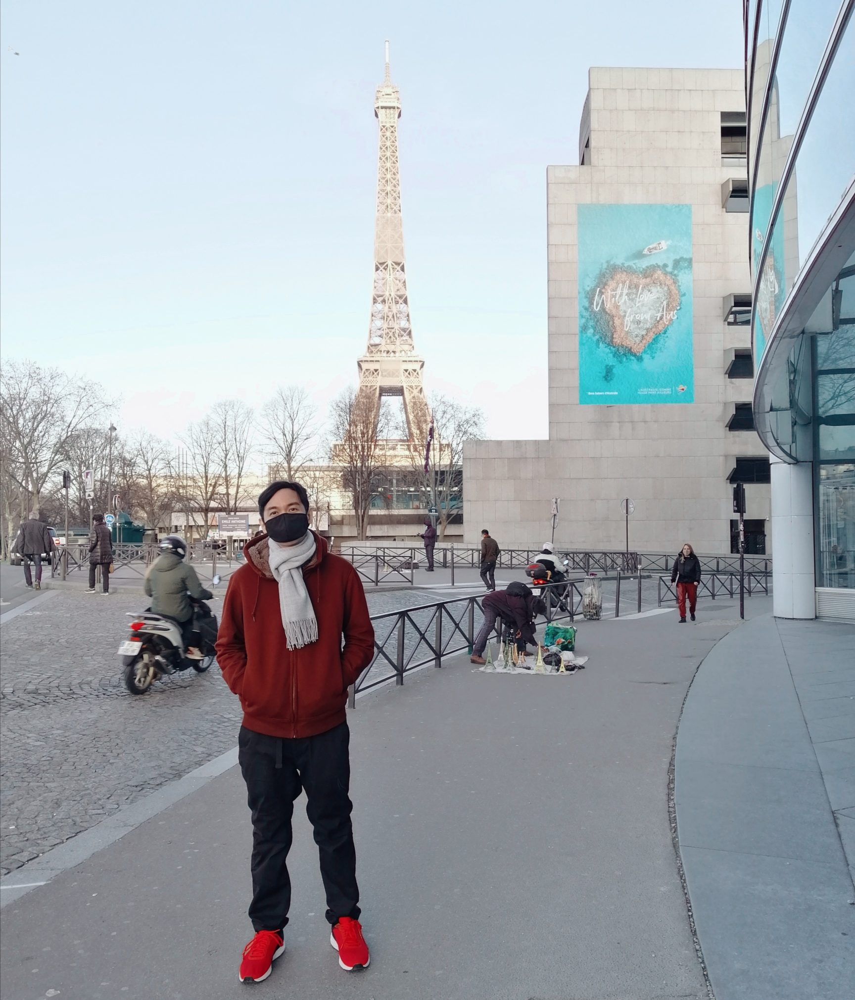
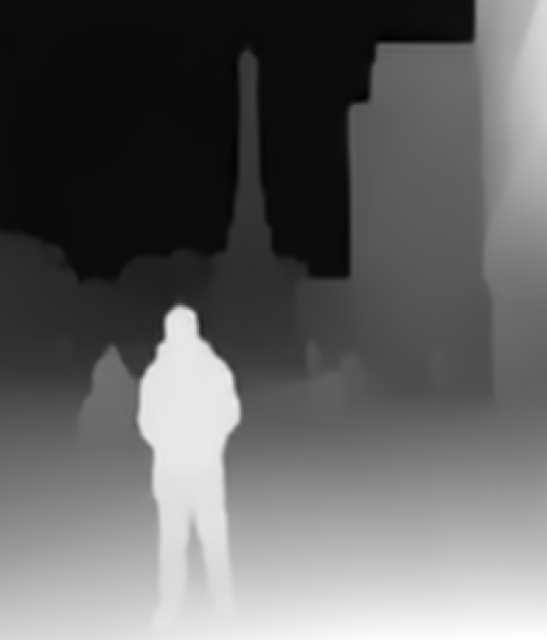

In [ ]:
show_depth_estimation('image/paris.jpg', 'depth/paris.png')

### Results

Here are the 3D inpainting of the two images:


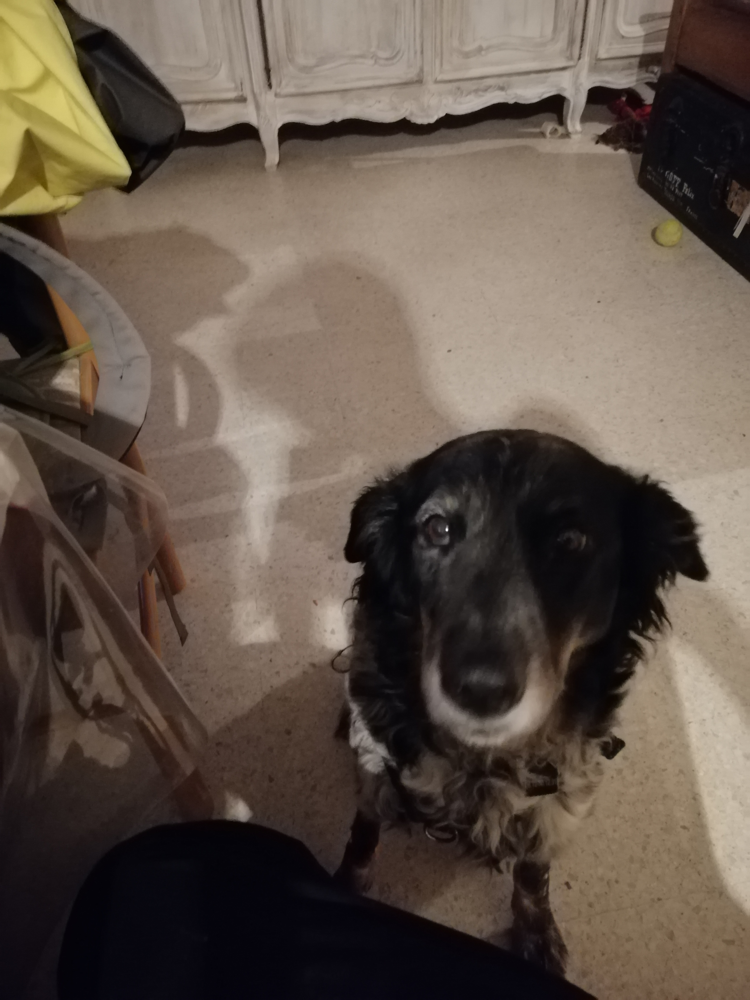

In [ ]:
show_inpainting('image/dog.jpg', 'video/dog_swing.mp4')


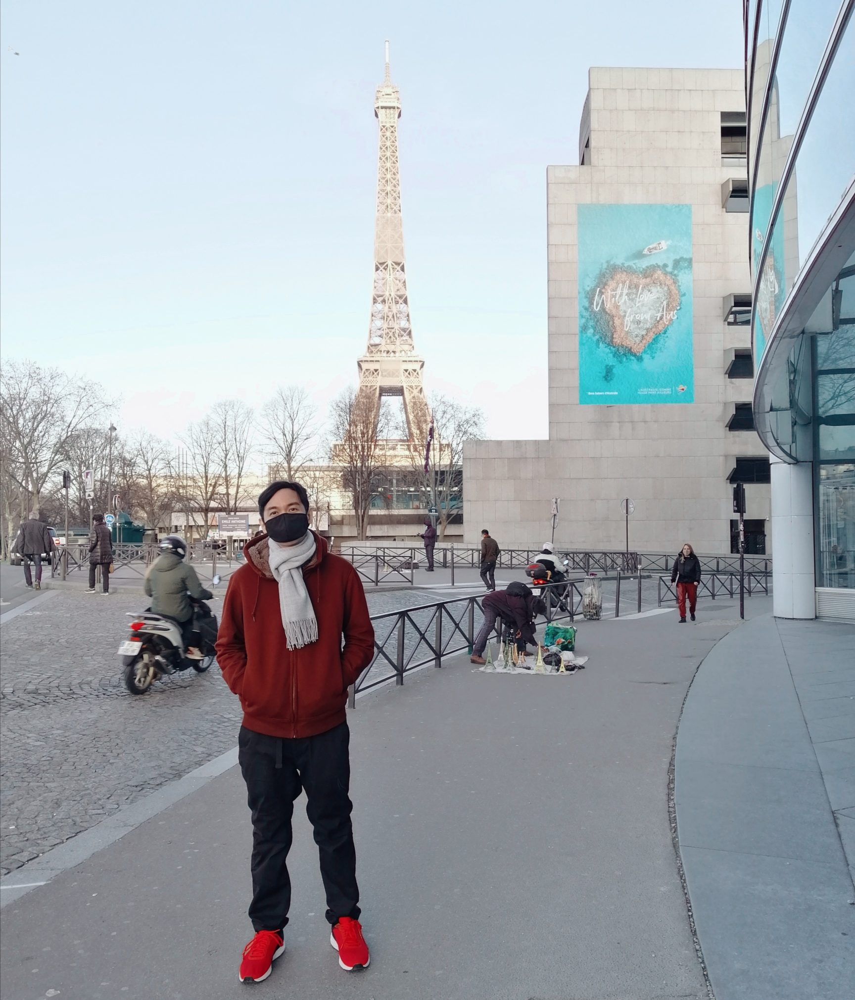

In [ ]:
show_inpainting('image/paris.jpg', 'video/paris_dolly-zoom-in.mp4')


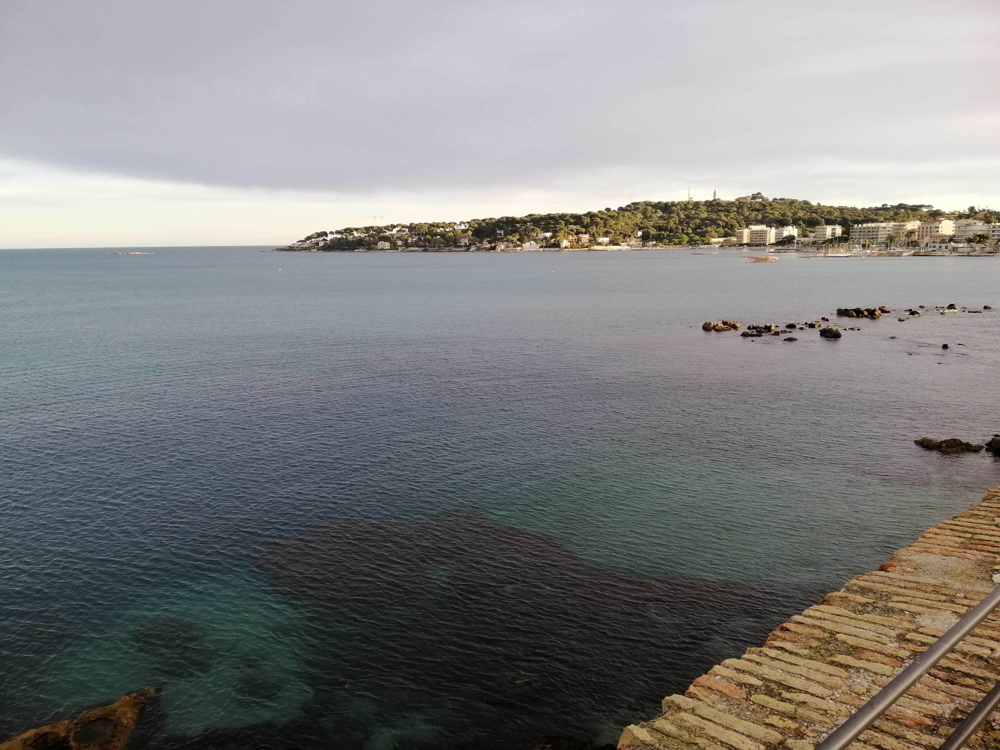

In [ ]:
show_inpainting('image/sea.jpg', 'video/sea_circle.mp4')

## How does it work?

Here is a high level overview:

- Get the depth of each pixel (how far back is from the camera)
 - RGB-D image from a dual-camera device (phone)

 or

 - Depth estimation with MiDaS: https://github.com/intel-isl/MiDaS
- Create LDI (layered depth image) representation
- Detect regions with a high depth difference (context/synthesis regions)
- Cut out those regions (this roughly resembles cutting out objects from the image)
- Generate the background behind the cut off objects
- Merge the background and cut out objects into a new LDI

The process is a lot more involved (including heavy image preprocessing), but you need to read the paper/code to get into the details.

## What was the training data?

The authors didn't create a special dataset for their task. They generate data.

First, the depth of images from the [MSCOCO dataset](http://cocodataset.org/) is estimated using a pre-trained [MegaDepth model](https://research.cs.cornell.edu/megadepth/). Then context/synthesis regions are extracted. A random sample of regions is merged with a set of images from the MSCOCO dataset. Thus, you get the ground truth of the backgrounds.